# Data Mining - Assignment 2: 
# Crime Data Exploration

by Athanasia Tournaki (1115201600172) and Dimitrios Milonopoulos (1115201600112)

In this assignment, we were tasked to explore a set of crime data from the Boston Crime Database and extract information in order to answer given questions.

#### Importing some useful libraries

In [85]:
import numpy as np
import pandas as pd
# visualization
import seaborn as sns #optional but nice to have!!!
import matplotlib.pyplot as plt
%matplotlib inline

#### Importing Crime Data

In [86]:
df = pd.read_csv('crime.csv',dtype={'REPORTING_AREA':object},encoding="ISO-8859-1")
df = df.drop(['OFFENSE_DESCRIPTION', 'REPORTING_AREA', 'OCCURRED_ON_DATE', 'UCR_PART', 'STREET'], axis=1)

C:\Users\Nasquik\Anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3049: DtypeWarning: Columns (6) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [87]:
df['SHOOTING'] = df['SHOOTING'].fillna('N')

## How many crimes are committed per year, per month, per day? 
## How many per district?

In [88]:
import datetime

#### Crimes Per Year

In [89]:
year_group = pd.DataFrame(df.groupby('YEAR')['YEAR'].count())
year_group.columns = ['COUNT']

#### Crimes Per Month

In [90]:
month_group = pd.DataFrame(df.groupby('MONTH')['MONTH'].count())
month_group.columns = ['COUNT']

In [91]:
month_dict = {1:'January',2:'February',3:'March',4:'April',5:'May',6:'June',7:'July',8:'August',
              9:'September',10:'October',11:'November',12:'December'}

In [92]:
index_months = [month_dict[value] for value in month_group.index.values]

#### Crimes Per Day

In [93]:
day_week_group = pd.DataFrame(df.groupby('DAY_OF_WEEK')['DAY_OF_WEEK'].count())
day_week_group.columns = ['COUNT']

In [94]:
cats = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_week_group = day_week_group.reindex(cats)

#### Crimes Per District

In [95]:
district_group = pd.DataFrame(df.groupby('DISTRICT')['DISTRICT'].count())
district_group.columns = ['COUNT']

### Visualizing the data

#### Number of crimes per Year

In [96]:
year_group

,COUNT
YEAR,
2015,53392
2016,99134
2017,100938
2018,74356


(array([0, 1, 2, 3]), <a list of 4 Text xticklabel objects>)

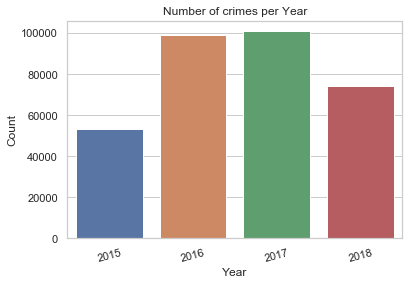

In [97]:
sns.set(style="whitegrid")
ax = sns.barplot(x=year_group.index.values,y='COUNT',data = year_group)
ax.set_title("Number of crimes per Year")
ax.set_xlabel("Year")
ax.set_ylabel("Count")
plt.xticks(rotation=15)

As shown above, we can conclude that, since 2015, crime rates have increased greatly, with twice as many reported crimes in 2016 and 2017. A slight decrease can be observed in 2018, when the rate dropped to 25% less, compared to the 2016-2017 period. 

#### Number of crimes per Month

In [98]:
month_group

,COUNT
MONTH,
1,23625
2,21661
3,24156
4,24108
5,26242
6,30622
7,34640
8,35137
9,34023


(array([    0.,  5000., 10000., 15000., 20000., 25000., 30000., 35000.,
        40000.]), <a list of 9 Text xticklabel objects>)

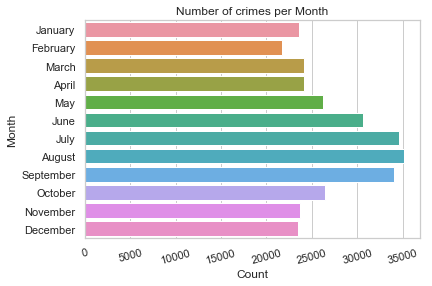

In [99]:
sns.set(style="whitegrid")
ax = sns.barplot(y=index_months,x='COUNT',data = month_group)
ax.set_title("Number of crimes per Month")
ax.set_xlabel("Count")
ax.set_ylabel("Month")
plt.xticks(rotation=15)

It is evident from the chart above that criminal activity is at its peak during the summer months. It is also increased around that period, with a slight drop in the winter.

#### Number of Crimes per Day

In [100]:
day_week_group

,COUNT
DAY_OF_WEEK,
Monday,46970
Tuesday,47726
Wednesday,48151
Thursday,47872
Friday,49758
Saturday,45969
Sunday,41374


(array([    0., 10000., 20000., 30000., 40000., 50000., 60000.]),
 <a list of 7 Text xticklabel objects>)

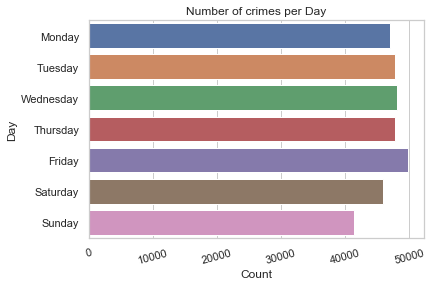

In [101]:
sns.set(style="whitegrid")
ax = sns.barplot(y=day_week_group.index.values,x='COUNT',data = day_week_group)
ax.set_title("Number of crimes per Day")
ax.set_xlabel("Count")
ax.set_ylabel("Day")
plt.xticks(rotation=15)

As one can see, crimes are committed more commonly on Fridays. The rest of the days are almost at a tie, except from Sunday, when the crime rate is lower than average.

#### Number of Crimes per District

In [102]:
district_group

,COUNT
DISTRICT,
A1,36735
A15,6663
A7,13634
B2,51288
B3,36400
C11,43817
C6,24190
D14,20632
D4,43338


(array([    0., 10000., 20000., 30000., 40000., 50000., 60000.]),
 <a list of 7 Text xticklabel objects>)

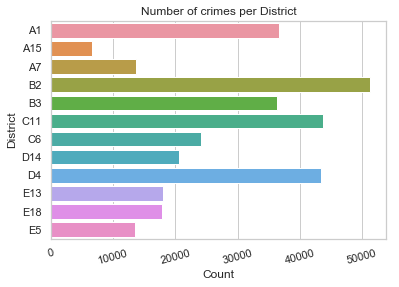

In [103]:
sns.set(style="whitegrid")
ax = sns.barplot(y=district_group.index.values,x='COUNT',data = district_group)
ax.set_title("Number of crimes per District")
ax.set_xlabel("Count")
ax.set_ylabel("District")
plt.xticks(rotation=15)

## In which year did most shootings occur?
## In which district?

#### Year

In [104]:
most_shootings_year = pd.DataFrame(df[df.SHOOTING=='Y'].groupby(['YEAR'])['SHOOTING'].count())
most_shootings_year.columns = ['COUNT']

#### District

In [105]:
most_shootings_district = pd.DataFrame(df[df.SHOOTING=='Y'].groupby(['DISTRICT'])['SHOOTING'].count())
most_shootings_district.columns = ['COUNT']

In [106]:
most_shootings_district = most_shootings_district.sort_values(by = ['COUNT'], ascending = False)

### Visualizing the Data

#### Year when most shootings occurred

In [107]:
most_shootings_year

,COUNT
YEAR,
2015,185
2016,279
2017,371
2018,220


(array([0, 1, 2, 3]), <a list of 4 Text xticklabel objects>)

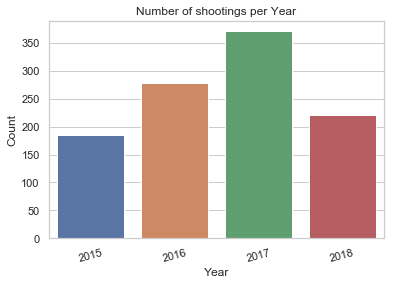

In [108]:
sns.set(style="whitegrid")
ax = sns.barplot(x=most_shootings_year.index.values,y='COUNT',data = most_shootings_year)
ax.set_title("Number of shootings per Year")
ax.set_xlabel("Year")
ax.set_ylabel("Count")
plt.xticks(rotation=15)

In the preceding graph, it is apparent that most shootings occurred in the year 2017, which was also the year with the most criminal activity overall. 

#### District where most shootings occurred

In [109]:
most_shootings_district

,COUNT
DISTRICT,
B2,352
B3,227
C11,195
E13,70
D4,59
C6,41
E18,35
D14,21
E5,19


(array([  0.,  50., 100., 150., 200., 250., 300., 350., 400.]),
 <a list of 9 Text xticklabel objects>)

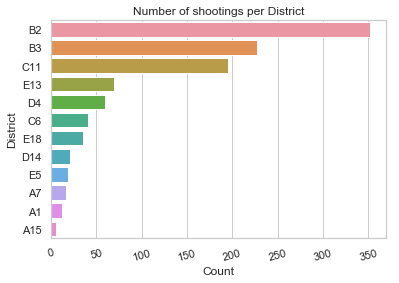

In [110]:
sns.set(style="whitegrid")
ax = sns.barplot(y=most_shootings_district.index.values,x='COUNT',data = most_shootings_district)
ax.set_title("Number of shootings per District")
ax.set_xlabel("Count")
ax.set_ylabel("District")
plt.xticks(rotation=15)

In the preceding graph, it is apparent that most shootings occurred in the B2 District, which was also the district where most of the criminal activity took place overall. 

## Did more crimes occur during the day or during the night?

In [111]:
df.loc[(df.HOUR >= 18) | (df.HOUR < 6), 'DAY_OR_NIGHT'] = 'Night'
df.loc[(df.HOUR < 18) & (df.HOUR >= 6), 'DAY_OR_NIGHT'] = 'Day'
dayNightCount = pd.DataFrame(df.groupby('DAY_OR_NIGHT')['DAY_OR_NIGHT'].count())
dayNightCount.columns = ['COUNT']

### Visualizing the Data

In [112]:
dayNightCount

,COUNT
DAY_OR_NIGHT,
Day,189442
Night,138378


(array([0, 1]), <a list of 2 Text xticklabel objects>)

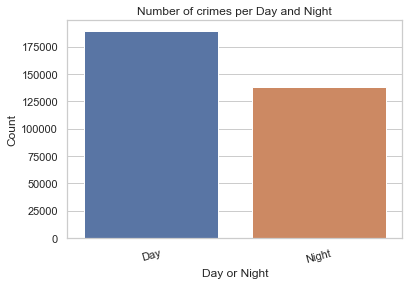

In [113]:
sns.set(style = "whitegrid")
ax = sns.barplot(x = dayNightCount.index.values, y = "COUNT", data = dayNightCount)
ax.set_title("Number of crimes per Day and Night")
ax.set_xlabel("Day or Night")
ax.set_ylabel("Count")
plt.xticks(rotation=15)

It can be observed that most crimes occur during the day.

## Which is the most common type of crime that occurs during the day?

In [114]:
crimeDay_df = pd.DataFrame(df[df.DAY_OR_NIGHT == 'Day'].groupby('OFFENSE_CODE_GROUP')['OFFENSE_CODE_GROUP'].count())
crimeDay_df.columns = ['COUNT']

In [115]:
most_common_crime = pd.DataFrame(df[df.DAY_OR_NIGHT == 'Day'].groupby('OFFENSE_CODE_GROUP')['OFFENSE_CODE_GROUP'].count())
most_common_crime.columns = ['COUNT']

In [116]:
most_common_crime = most_common_crime.sort_values(by = ['COUNT'], ascending = False)
most_common_crime = pd.DataFrame(most_common_crime.head(10))

(array([    0.,  5000., 10000., 15000., 20000., 25000.]),
 <a list of 6 Text xticklabel objects>)

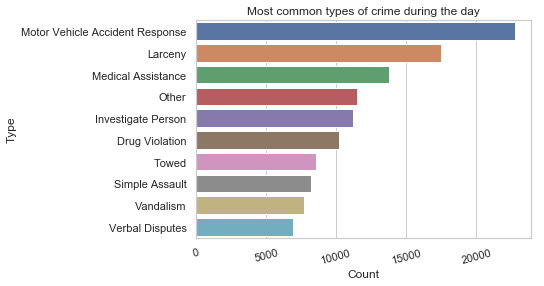

In [117]:
sns.set(style="whitegrid")
ax = sns.barplot(y=most_common_crime.index.values,x='COUNT',data = most_common_crime)
ax.set_title("Most common types of crime during the day")
ax.set_xlabel("Count")
ax.set_ylabel("Type")
plt.xticks(rotation=15)

Looking at the chart above, one can notice that the most common incident happening during the day is a Motor Vehicle Accident.

## Use of K-Means for Data Clustering

#### Importing the required libraries

In [118]:
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
%matplotlib inline

#### Dropping the N/A values from the DataFrame 'Lat' and 'Long' columns and enclose the coordinate value range

In [119]:
coordinates = df.loc[:,['Lat','Long']]
coordinates = coordinates.dropna()
coordinates = coordinates.loc[(coordinates['Lat'] > 40) & (coordinates['Long'] < -60)]

### Visualizing the crime incidents according to their coordinates

Text(0, 0.5, 'Latitude')

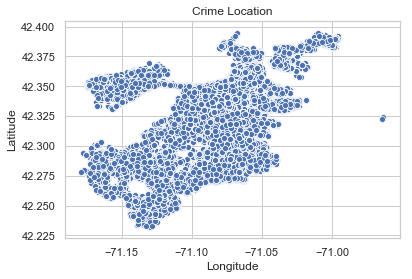

In [120]:
ax = sns.scatterplot(x = "Long", y = "Lat", data = coordinates)
ax.set_title("Crime Location")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

## K-means clustering

### (K = 2)

In [121]:
km = KMeans(n_clusters = 2)
km.fit(coordinates)
coord_prediction = km.predict(coordinates)
labels =km.labels_

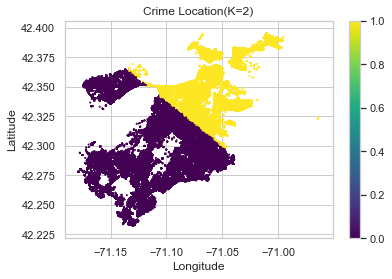

In [122]:
fig = plt.figure()
ax = fig.add_subplot(111)
scatter = ax.scatter(x = coordinates['Long'], y = coordinates['Lat'], c = coord_prediction, cmap='viridis', s = 1)
ax.set_title("Crime Location(K=2)")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.colorbar(scatter)

### (K = 3)

In [123]:
km = KMeans(n_clusters = 3)
km.fit(coordinates)
coord_prediction = km.predict(coordinates)
labels =km.labels_

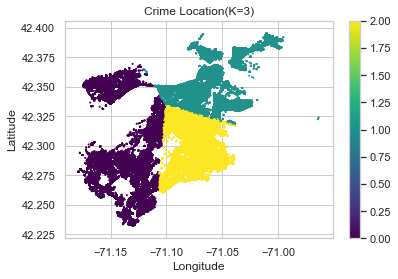

In [124]:
fig = plt.figure()
ax = fig.add_subplot(111)
scatter = ax.scatter(x = coordinates['Long'], y = coordinates['Lat'], c = coord_prediction, cmap='viridis', s = 1)
ax.set_title("Crime Location(K=3)")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.colorbar(scatter)

### (K = 5)

In [125]:
km = KMeans(n_clusters = 5)
km.fit(coordinates)
coord_prediction = km.predict(coordinates)
labels =km.labels_

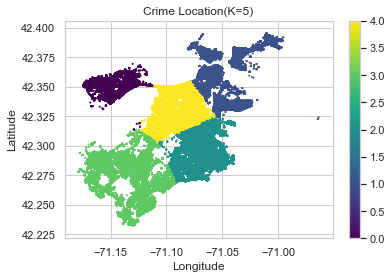

In [126]:
fig = plt.figure()
ax = fig.add_subplot(111)
scatter = ax.scatter(x = coordinates['Long'], y = coordinates['Lat'], c = coord_prediction, cmap='viridis', s = 1)
ax.set_title("Crime Location(K=5)")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.colorbar(scatter)

### (K = 10)

In [127]:
km = KMeans(n_clusters = 10)
km.fit(coordinates)
coord_prediction = km.predict(coordinates)
labels =km.labels_

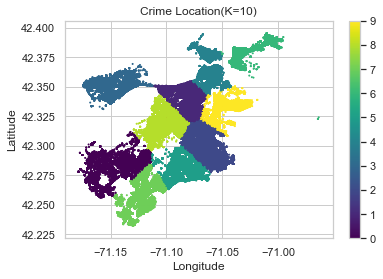

In [128]:
fig = plt.figure()
ax = fig.add_subplot(111)
scatter = ax.scatter(x = coordinates['Long'], y = coordinates['Lat'], c = coord_prediction, cmap='viridis', s = 1)
ax.set_title("Crime Location(K=10)")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.colorbar(scatter)

## 3-dimensional K-means, using coordinates combined with offense code

In [129]:
coordinates = df.loc[:,['Lat','Long','OFFENSE_CODE']]
coordinates = coordinates.dropna()
coordinates = coordinates.loc[(coordinates['Lat'] > 40) & (coordinates['Long'] < -60)]

### (K = 2)

In [130]:
km = KMeans(n_clusters=2)
km.fit(coordinates)

KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=None, precompute_distances='auto',
    random_state=None, tol=0.0001, verbose=0)

In [131]:
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

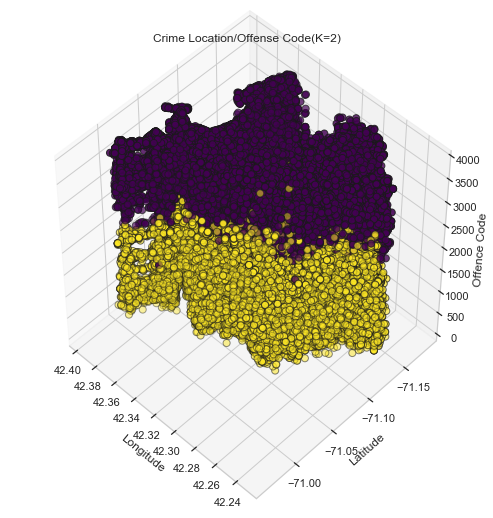

In [132]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['OFFENSE_CODE'],c=coord_pred,cmap='viridis', edgecolor = "k", s=50)
ax.set_title("Crime Location/Offense Code(K=2)")
ax.set_zlabel('Offence Code', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

### (K = 3)

In [133]:
km = KMeans(n_clusters=3)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

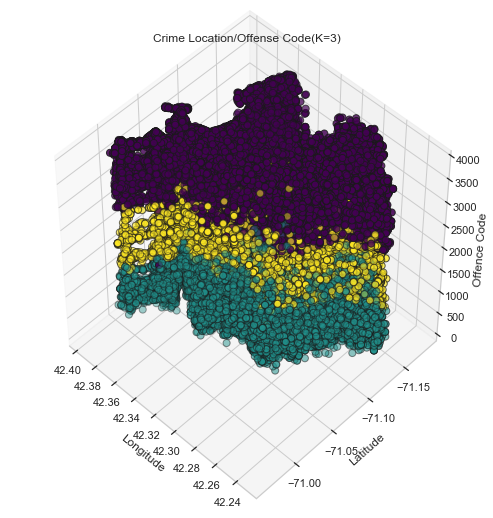

In [134]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['OFFENSE_CODE'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Offense Code(K=3)")
ax.set_zlabel('Offence Code', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

### (K = 5)

In [135]:
km = KMeans(n_clusters=5)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

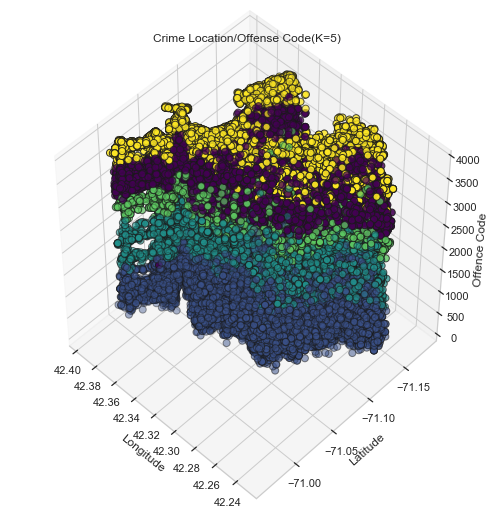

In [136]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['OFFENSE_CODE'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Offense Code(K=5)")
ax.set_zlabel('Offence Code', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

### (K = 10)

In [137]:
km = KMeans(n_clusters=10)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

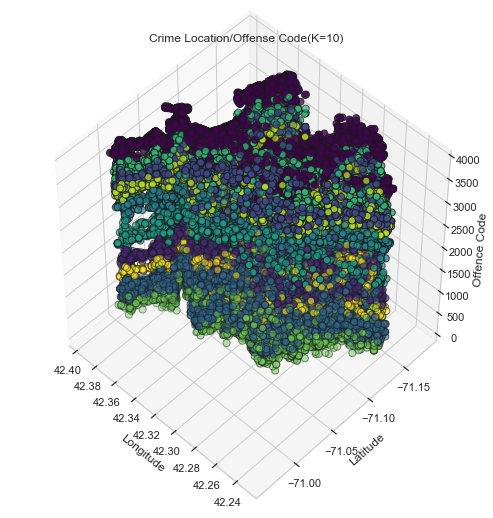

In [138]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['OFFENSE_CODE'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Offense Code(K=10)")
ax.set_zlabel('Offence Code', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

## 3-dimensional K-means, using coordinates combined with the month that each crime occurred

In [139]:
coordinates = df.loc[:,['Lat','Long','MONTH']]
coordinates = coordinates.dropna()
coordinates = coordinates.loc[(coordinates['Lat'] > 40) & (coordinates['Long'] < -60)]

## (K = 2)

In [140]:
km = KMeans(n_clusters=2)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

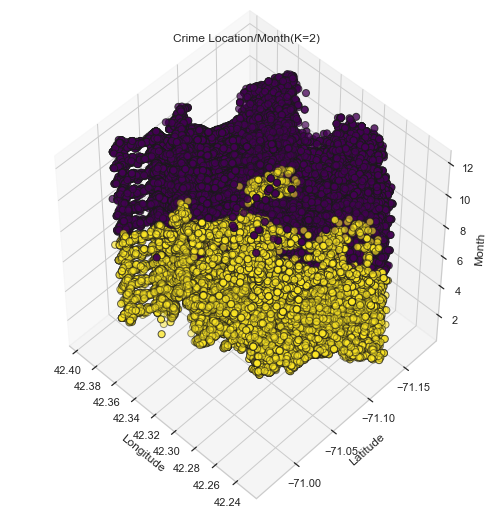

In [141]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['MONTH'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Month(K=2)")
ax.set_zlabel('Month', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

## (K = 3)

In [142]:
km = KMeans(n_clusters=3)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

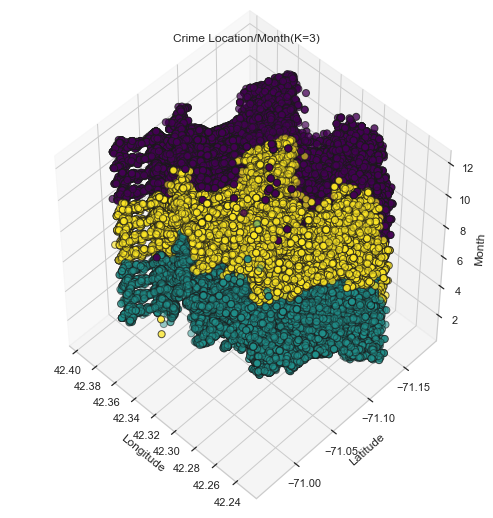

In [143]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['MONTH'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Month(K=3)")
ax.set_zlabel('Month', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

## (K = 5)

In [144]:
km = KMeans(n_clusters=5)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

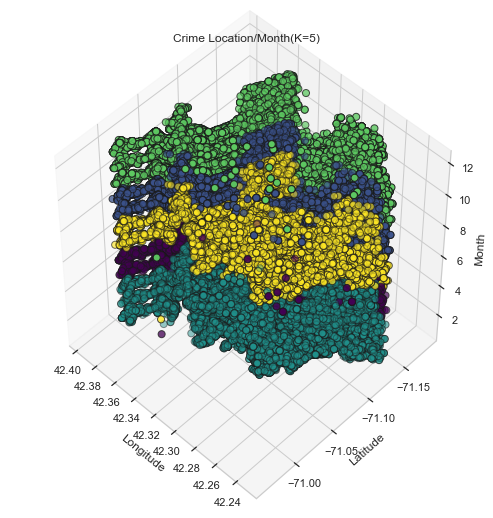

In [145]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['MONTH'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Month(K=5)")
ax.set_zlabel('Month', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

## (K = 10)

In [146]:
km = KMeans(n_clusters=10)
km.fit(coordinates)
coord_pred = km.predict(coordinates)
labels = km.labels_

Text(0.5, 0, 'Latitude')

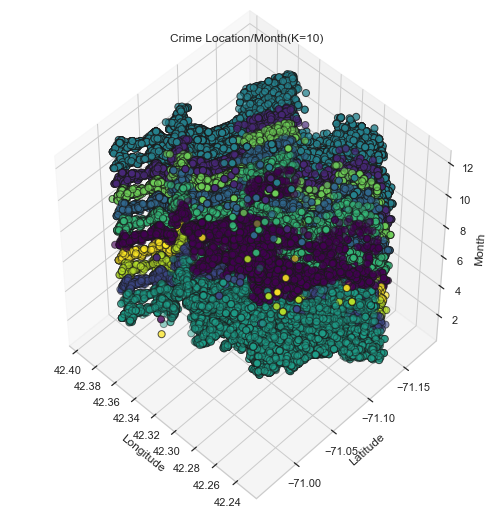

In [147]:
fig = plt.figure(1,figsize=(7,7))
ax = Axes3D(fig,rect=[0,0,0.95,1],elev=48,azim=134)
ax.scatter(coordinates['Lat'],coordinates['Long'],coordinates['MONTH'],c=coord_pred, edgecolor = "k",s=50,cmap='viridis')
ax.set_title("Crime Location/Month(K=10)")
ax.set_zlabel('Month', rotation = 0)
ax.set_xlabel("Longitude", rotation = -50)
ax.set_ylabel("Latitude", rotation = 50)

## Creating an interactive Map for the Crime Data with the usage of the folium library

In [152]:
import folium
from folium.plugins import MarkerCluster

m = folium.Map(location=[40, -60], zoom_start=5)
marker_cluster = MarkerCluster().add_to(m)

For this visualization 'Motor Vehicle Accident Response' was the crime selected, as it was the most frequent among all crimes.

In [153]:
location = df.loc[:,['Lat','Long','OFFENSE_CODE_GROUP']]
location = location.dropna()
location = pd.DataFrame(location)
#location = location.loc[(location['Lat'] > 40) & (location['Long'] < -60)]
location = location[location.OFFENSE_CODE_GROUP == 'Motor Vehicle Accident Response']

#### Adding each crime coordinates into the map

Due to limitations in the Jupyter Notebook's data output size, the interactive map can only be used via opening the .html file from the browser of your preference.

In [154]:
for index, row in location.iterrows():
    folium.Marker(
        location=[row['Lat'], row['Long']],
        popup='Motor Vehicle Accident Response.',
        icon=None,
    ).add_to(marker_cluster)

m.save('MotorVehicleAccidentMap.html')
m